# **1) Overview**

###**1.1	Problem Description**

Instacart is the company that half of American households use to get groceries from their favorite grocery stores like Costco, Wegman’s, Wallmart, Whole Foods, Petco, and more without even leaving the house.
Whether you shop from meticulously planned grocery lists or shop just for the heck of it, our unique food rituals define who we are. Instacart, a grocery ordering and delivery app, aims to make it easy to fill your refrigerator and pantry with your personal favorites and staples when you need them. After selecting products through the Instacart app, personal shoppers review your order and do the in-store shopping and delivery for you.
Instacart’s data science team plays a big part in providing this delightful shopping experience. Currently they use transactional data to develop models that predict which products a user will buy again, try for the first time, or add to their cart next during a session. Recently, Instacart open sourced this data - see their blog post on 3 Million Instacart Orders, Open Sourced.

Instacart currently uses XGBoost, word2vec and Annoy in production on similar data to sort items for users to “buy again”:

Context: Source: https://www.kaggle.com/competitions/instacart-market-basket-analysis/overview



##**1.2 Problem Statement**

To use this data of customer orders over time to predict which previously purchased products will be in a user’s next order.


##**1.3 Instacart’s Business Model**

**The users experience.**
1.	Download the Instacart App.
2.	Choose a store to shop from.
3.	From the store’s inventory, select which items you want to add to your cart.
4.	Select a one-hour time window during which you want your groceries to be delivered, which could be within the next hour.
<img src='https://tikolu.net/i/zljyl' />


**The delivery persons experience.**
1.	In the Instacart app, the shopper is on their shift, and are given a chance to acknowledge an order when it comes in the system.
2.	They drive to the store of that order and are presented with a list of the items you would like to purchase.
3.	As they find items, they pick them up, and scan the barcode to make sure it is the exact version of the product that you want.
4.	They would check out and drive to your address to deliver your groceries.
<img src='https://tikolu.net/i/vphrc' />

There’s two obvious sides to this marketplace — the shopper and the client.<br> However, Instacart is actually a four-sided marketplace.
<img src='https://tikolu.net/i/cseaq' />

Source: https://towardsdatascience.com/how-instacart-uses-data-science-to-tackle-complex-business-problems-774a826b6ed5


##**1.4. Real-world/ Business objectives and constraints.** 
*	No low-latency requirement. 
*	Some Interpretability will help.
*	 Errors are not very costly. Probability that customer will buy the particular product is needed.


##**1.5.  Dataset overview**

The dataset consists of over 3 million grocery orders from more than 200,000 Instacart users. For each user, we have around 4 to 100 of their orders, with the sequence of products purchased in each order.
This Dataset comes with 6 different CSV files such as:-<br><br>
**1. products.csv**
*	product_id: Provides id of the product. (Primary key)
*	product_name: Provides a name of every product.
Eg: Peach Mango Juice, Fresh Foaming Cleanser
*	department_id: It provides which department_id the particular product belongs to.
*	aisle_id: It provides which aisle_id the particular product belongs to. 
Aisle: Just like customers walk up and down the aisles when they go in-person, consumers usually take a ‘what sounds good’ approach for some of the items they buy. In these moments, consumers are looking for something to catch their eye without explicitly stating what they’re after.<br><br>

**2.	orders.csv**
*	order_id: Provides id of the order. (Primary key)
*	user_id: Provides id of the user. (Foreign  key)
*	eval_set: Provides info about which dataset this order belongs to.<br>
(i)	Prior: Users previous order history. ----> (build model)<br>
(ii)	Train: Data to be used to train the model.  ----> (use as validation set)<br>
(iii)	Test: Data to be used to test the model.  ----> (use to test model)<br>
*	order_number: Provides order number made by the user.
*	order_dow: Which day of the week user placed the order. Range [0-6]
*	order_hour_of_day: Which hour of day user placed the order. Range [0-23]
*	days_since_prior_order: How many days ago the user placed the order. Range 
[0-30]<br><br>

**3.	order_products__train.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**4.	order_products__prior.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**5.	 aisles.csv**
*	aisle_id: Provides id to every aisle name. (Primary key)
*	aisle: Name of the aisle. Eg. frozen meat seafood, baby bath body care<br><br>

**6.	 departments.csv**
*	department_id: Provides id to every department name. (Primary key)
*	department: Name of the department. Eg. Frozen, babies<br><br>
<img src='https://tikolu.net/i/xobeg' />

Image: https://blog.ineuron.ai/Instacart-Customer-Basket-Analysis-Case-Study-oYecAA8f


*  Quantity and price of a product bought in a single order is not given.

##**1.6. Notebook split up into 4 major tasks** 
1. Cluster user into groups based on Buying habits/ Loyalty
2. ### 	**Predicts if user will reorder product or not** 
u1 -->  x,y   (assume user1 is likely to reorder products x and y, then these 2 will be recommended.) <br><br>
3.	Show similar products to x and y to user u1 
4.	Suggest products to buy along with products x and y. (Making bundles for user)

###**1.7 Mapping the real world problem to a Machine Learning Problem**

**Type of Machine Learning Problem**

For a given customer and product ordered previosly we need to predict whether customer is going to reorder the product or not.

Therefore this is a binary classification where 0 => will not reorder and 1 => will reorder.

**Performance metric**



# **Import Everything + helper functions**

In [ ]:
###########################  Basic  #############################
from IPython.display import set_matplotlib_formats


import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
import gdown
import os, zipfile
import shutil
import pandas as pd
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from google.colab import drive
set_matplotlib_formats('pdf', 'svg')

%matplotlib inline


###########################  clustering  #############################


import statsmodels.api as sm
sns.set()
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
from yellowbrick.cluster import KElbowVisualizer
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
plt.style.use('default')



def connect_to_drive():
  """Connects to Drive
  """
  drive.mount('/content/drive')



def remove_dir(abs_path):
  """Removes entire folder and all folders/files present in it.
  """
  try:
    shutil.rmtree(abs_path)
  except:
    print("No such folder present")
  else:
    print("Deleted successfully")



def nans_by_row(df): 
  """ 
  Filters dataframe and returns only those rows that have atleast 1 NaN value
  """
  return df[df.isnull().any(axis=1)]


def histplot(data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False):
    """ 
    Plots histogram for inputed data.  
    params --> (data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False)
    """
    
    plt.rcParams["figure.figsize"] = (w,h)
    plt.rcParams["xtick.labelsize"] = x_labelsize

    ax = sns.histplotlot(x=data,stat=stat, kde=True,bins = bins, cumulative = cumulative)
    ax.set(xlabel='days since prior order', ylabel='density',title='PDF of re-order frequency')
    ax.set_xticks(range(0,int(max(data)) + xticks_step_size, xticks_step_size))
    plt.show()


def save_csv(df , file_name):
  df.to_csv(file_name)




def univariate_analysis(X, variable_name):
    plt.rcParams["figure.figsize"] = (15,5)

    f, (a0, a1, a2) = plt.subplots(1, 3, gridspec_kw={'width_ratios': [30, 30, 10]})

    sns.kdeplot(X , fill = True, ax = a0)
    a0.set_title('PDF', fontsize=10)
    a0.set_xlabel(variable_name, fontsize=10)

    sns.kdeplot(X, fill = True, cumulative=True, ax = a1)
    a1.set_title('CDF', fontsize=10)
    a1.set_xlabel(variable_name, fontsize=10)


    a2.boxplot(X)
    a2.set_title('Box plot', fontsize=8)
    a2.set_ylabel(variable_name, fontsize=10)
    a2.set_xlabel('users', fontsize=10)



from IPython.display import display_html

def add_user_feature(u_features, new_feature):
    print("before adding feature", u_features.shape)
    u_features = pd.merge(u_features, new_feature, on='user_id',how='left')
    print("After adding feature", u_features.shape)
    
    display_html(u_features.head())
    return u_features



def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    print("Number of misclassified points ",(len(test_y)-np.trace(C))/len(test_y)*100)
    # C = 9,9 matrix, each cell (i,j) represents number of points of class i are predicted class j
    A =(((C.T)/(C.sum(axis=1))).T)
    #divid each element of the confusion matrix with the sum of elements in that column
    # C = [[1, 2],
    # [3, 4]]
    # C.T = [[1, 3],
    # [2, 4]]
    # C.sum(axis = 1) axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =1) = [[3, 7]]
    # ((C.T)/(C.sum(axis=1))) = [[1/3, 3/7]
    # [2/3, 4/7]]
    # ((C.T)/(C.sum(axis=1))).T = [[1/3, 2/3]
    # [3/7, 4/7]]
    # sum of row elements = 1
    B =(C/C.sum(axis=0))
    #divid each element of the confusion matrix with the sum of elements in that row
    # C = [[1, 2],
    # [3, 4]]
    # C.sum(axis = 0) axis=0 corresonds to columns and axis=1 corresponds to rows in two diamensional array
    # C.sum(axix =0) = [[4, 6]]
    # (C/C.sum(axis=0)) = [[1/4, 2/6],
    # [3/4, 4/6]]
    labels = [0,1]
    cmap=sns.light_palette("green")
    # representing A in heatmap format
    print("-"*50, "Confusion matrix", "-"*50)
    plt.figure(figsize=(10,5))
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()
    print("-"*50, "Recall matrix", "-"*50)

    # -------------------------------------------------- Confusion matrix ---------------------------------------------
    # -------------------------------------------------- Precision matrix ---------------------------------------------
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()

    # representing B in heatmap format
    print("-"*50, "Precision matrix" , "-"*50)
    plt.figure(figsize=(10,5))
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.show()


/usr/local/lib/python3.7/dist-packages/html5lib/_trie/_base.py:3: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping
/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: 

# **Getting dataset**

In [ ]:
import gdown
import os, zipfile
#https://github.com/wkentaro/gdown

#downloading dataset
id = "1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU"
!mkdir /content/dataset
output = "/content/dataset/instacart-market-basket-analysis.zip"
gdown.download(id=id, output=output, quiet=False)


Downloading...
From: https://drive.google.com/uc?id=1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU
To: /content/dataset/instacart-market-basket-analysis.zip
100%|██████████| 206M/206M [00:03<00:00, 53.5MB/s]


'/content/dataset/instacart-market-basket-analysis.zip'

In [ ]:
# unzipping dataset
!unzip /content/dataset/instacart-market-basket-analysis.zip -d /content/dataset
os.remove("/content/dataset/instacart-market-basket-analysis.zip") # delete zipped file

Archive:  /content/dataset/instacart-market-basket-analysis.zip
  inflating: /content/dataset/aisles.csv.zip  
  inflating: /content/dataset/departments.csv.zip  
  inflating: /content/dataset/order_products__prior.csv.zip  
  inflating: /content/dataset/order_products__train.csv.zip  
  inflating: /content/dataset/orders.csv.zip  
  inflating: /content/dataset/products.csv.zip  
  inflating: /content/dataset/sample_submission.csv.zip  


In [ ]:
# unzipping internal files
# https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5


dir_name = '/content/dataset'
extension = ".zip"

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension) and item!="instacart-market-basket-analysis.zip": # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [ ]:
# delete dir
remove_dir("/content/dataset/__MACOSX")

Deleted successfully


# **Load/View datasets**

In [ ]:
import pandas as pd
import numpy as np

connect_to_drive()


aisle_df = pd.read_csv("/content/dataset/aisles.csv")
dept_df = pd.read_csv("/content/dataset/departments.csv")
order_prod_pr_df = pd.read_csv("/content/dataset/order_products__prior.csv")
order_prod_tr_df = pd.read_csv("/content/dataset/order_products__train.csv")
orders_df = pd.read_csv("/content/dataset/orders.csv")
products_df = pd.read_csv("/content/dataset/products.csv")


#**********************************user_prod_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_prod_features.csv", "/content/")
uxp_features = pd.read_csv('/content/user_prod_features.csv', index_col = 0)


#**********************************user_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_features.csv", "/content/")
user_features = pd.read_csv('/content/user_features.csv', index_col = 0)


# #**********************************prod_features*******************************************#
shutil.copy( "/content/drive/MyDrive/assignment datsets/product_features.csv", "/content/")
product_features = pd.read_csv('/content/product_features.csv', index_col = 0)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
aisle_df.info()
aisle_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134 entries, 0 to 133
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   aisle_id  134 non-null    int64 
 1   aisle     134 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.2+ KB


,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation
...,...,...
129,130,hot cereal pancake mixes
130,131,dry pasta
131,132,beauty
132,133,muscles joints pain relief


In [ ]:
dept_df.info()
dept_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   department_id  21 non-null     int64 
 1   department     21 non-null     object
dtypes: int64(1), object(1)
memory usage: 464.0+ bytes


,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol
5,6,international
6,7,beverages
7,8,pets
8,9,dry goods pasta
9,10,bulk


In [ ]:
order_prod_pr_df.info()
order_prod_pr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32434489 entries, 0 to 32434488
Data columns (total 4 columns):
 #   Column             Dtype
---  ------             -----
 0   order_id           int64
 1   product_id         int64
 2   add_to_cart_order  int64
 3   reordered          int64
dtypes: int64(4)
memory usage: 989.8 MB


,order_id,product_id,add_to_cart_order,reordered
0,2,33120,1,1
1,2,28985,2,1
2,2,9327,3,0
3,2,45918,4,1
4,2,30035,5,0
...,...,...,...,...
32434484,3421083,39678,6,1
32434485,3421083,11352,7,0
32434486,3421083,4600,8,0
32434487,3421083,24852,9,1


In [ ]:
order_prod_tr_df.info()
order_prod_tr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1384617 entries, 0 to 1384616
Data columns (total 4 columns):
 #   Column             Non-Null Count    Dtype
---  ------             --------------    -----
 0   order_id           1384617 non-null  int64
 1   product_id         1384617 non-null  int64
 2   add_to_cart_order  1384617 non-null  int64
 3   reordered          1384617 non-null  int64
dtypes: int64(4)
memory usage: 42.3 MB


,order_id,product_id,add_to_cart_order,reordered
0,1,49302,1,1
1,1,11109,2,1
2,1,10246,3,0
3,1,49683,4,0
4,1,43633,5,1
...,...,...,...,...
1384612,3421063,14233,3,1
1384613,3421063,35548,4,1
1384614,3421070,35951,1,1
1384615,3421070,16953,2,1


In [ ]:
orders_df.info()
orders_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3421083 entries, 0 to 3421082
Data columns (total 7 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   order_id                int64  
 1   user_id                 int64  
 2   eval_set                object 
 3   order_number            int64  
 4   order_dow               int64  
 5   order_hour_of_day       int64  
 6   days_since_prior_order  float64
dtypes: float64(1), int64(5), object(1)
memory usage: 182.7+ MB


,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
1,2398795,1,prior,2,3,7,15.0
2,473747,1,prior,3,3,12,21.0
3,2254736,1,prior,4,4,7,29.0
4,431534,1,prior,5,4,15,28.0
...,...,...,...,...,...,...,...
3421078,2266710,206209,prior,10,5,18,29.0
3421079,1854736,206209,prior,11,4,10,30.0
3421080,626363,206209,prior,12,1,12,18.0
3421081,2977660,206209,prior,13,1,12,7.0


In [ ]:
# Displays all rows with atleast 1 row with null value.
nans_by_row(orders_df)

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
11,2168274,2,prior,1,2,11,NaN
26,1374495,3,prior,1,1,14,NaN
39,3343014,4,prior,1,6,11,NaN
45,2717275,5,prior,1,3,12,NaN
...,...,...,...,...,...,...,...
3420930,969311,206205,prior,1,4,12,NaN
3420934,3189322,206206,prior,1,3,18,NaN
3421002,2166133,206207,prior,1,6,19,NaN
3421019,2227043,206208,prior,1,1,15,NaN


**observations/conclusions**

* Every users 1st order ever placed has days_since_prior_order as NaN, as there are no previous orders that they have placed.

In [ ]:
products_df.info()
products_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49688 entries, 0 to 49687
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   product_id     49688 non-null  int64 
 1   product_name   49688 non-null  object
 2   aisle_id       49688 non-null  int64 
 3   department_id  49688 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB


,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13
...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5
49684,49685,En Croute Roast Hazelnut Cranberry,42,1
49685,49686,Artisan Baguette,112,3
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8


In [ ]:
print("Total Users that placed orders:",len(orders_df['user_id'].unique()))
print("Total Products ever purchased:", len(products_df['product_id'].unique()))

Total Users that placed orders: 206209
Total Products ever purchased: 49688


In [ ]:
import gdown
import os, zipfile
#https://github.com/wkentaro/gdown

#downloading dataset
id = "1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU"
!mkdir /content/dataset
output = "/content/dataset/instacart-market-basket-analysis.zip"
gdown.download(id=id, output=output, quiet=False)


mkdir: cannot create directory ‘/content/dataset’: File exists


Downloading...
From: https://drive.google.com/uc?id=1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU
To: /content/dataset/instacart-market-basket-analysis.zip
100%|██████████| 206M/206M [00:00<00:00, 305MB/s]


'/content/dataset/instacart-market-basket-analysis.zip'

In [ ]:
# unzipping dataset
!unzip /content/dataset/instacart-market-basket-analysis.zip -d /content/dataset
os.remove("/content/dataset/instacart-market-basket-analysis.zip") # delete zipped file

Archive:  /content/dataset/instacart-market-basket-analysis.zip
  inflating: /content/dataset/aisles.csv.zip  
  inflating: /content/dataset/departments.csv.zip  
  inflating: /content/dataset/order_products__prior.csv.zip  
  inflating: /content/dataset/order_products__train.csv.zip  
  inflating: /content/dataset/orders.csv.zip  
  inflating: /content/dataset/products.csv.zip  
  inflating: /content/dataset/sample_submission.csv.zip  


In [ ]:
# unzipping internal files
# https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5


dir_name = '/content/dataset'
extension = ".zip"

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension) and item!="instacart-market-basket-analysis.zip": # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [ ]:
# delete dir
remove_dir("/content/dataset/__MACOSX")

Deleted successfully


# **Preparing data**

In [ ]:
orders_df[orders_df['eval_set']=='prior'].shape

(3214874, 7)

In [ ]:
orders_df[orders_df['eval_set']=='train'].shape

(131209, 7)

In [ ]:
orders_df[orders_df['eval_set']=='test'].shape

(75000, 7)

In [ ]:
#get user_loyalty dataset from to drive

connect_to_drive()

shutil.copy( "/content/drive/MyDrive/assignment datsets/user_loyalty.csv","/content/user_loyalty.csv")

user_loyalty_df = pd.read_csv("/content/user_loyalty.csv",index_col=0).reset_index()
user_loyalty_df.head()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
0,1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4
1,2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0
2,3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4
3,4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4
4,5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4


In [ ]:
# Using only prior user data 

orders_prior = orders_df[orders_df['eval_set'] == 'prior']
merg_df_prior = pd.merge(
              pd.merge(
                   pd.merge(
                       pd.merge(
                           order_prod_pr_df, 
                           orders_prior,on='order_id',
                           how='left')
                   ,products_df, on='product_id',how='left')
               ,aisle_df, on='aisle_id',how='left')
          ,dept_df, on='department_id',how='left')

merg_df_prior.sort_values(["user_id","order_id","product_id"], ascending=[True,True,False],inplace=True)
merg_df_prior.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
4089404,431534,41787,7,0,1,prior,5,4,15,28.0,Bartlett Pears,24,4,fresh fruits,produce
4089401,431534,25133,4,1,1,prior,5,4,15,28.0,Organic String Cheese,21,16,packaged cheese,dairy eggs
4089403,431534,17122,6,0,1,prior,5,4,15,28.0,Honeycrisp Apples,24,4,fresh fruits,produce
4089405,431534,13176,8,1,1,prior,5,4,15,28.0,Bag of Organic Bananas,24,4,fresh fruits,produce
4089399,431534,12427,2,1,1,prior,5,4,15,28.0,Original Beef Jerky,23,19,popcorn jerky,snacks


# **Recommender systems**

##**Popularity based item recommendation (Trending products at the moment)**

In [ ]:
# Number of products bought by each user
t = merg_df_prior.groupby(by=['product_id']).agg({"reordered":"count"}).reset_index()
t.rename(columns = {"reordered":"times_product_purchased"},inplace = True)
t

,product_id,times_product_purchased
0,1,1852
1,2,90
2,3,277
3,4,329
4,5,15
...,...,...
49672,49684,9
49673,49685,49
49674,49686,120
49675,49687,13


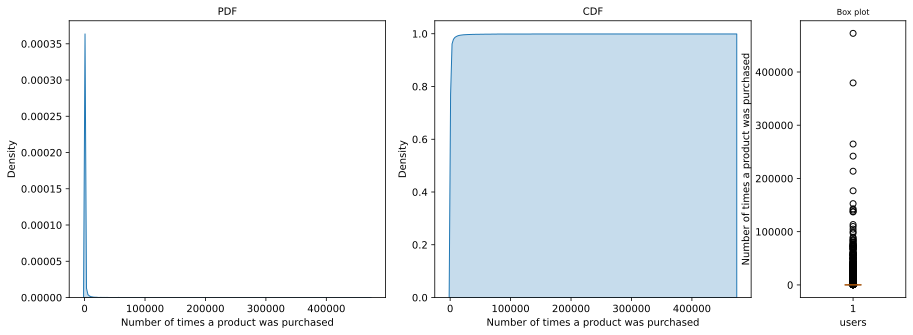

In [ ]:
univariate_analysis(t['times_product_purchased'], "Number of times a product was purchased")

**Product Features**

**f1) Average reorder ratio**



$$\frac{\text{total times the product was reordered}}{\text{total orders placed by all users}} $$

In [ ]:
p_reorder_ratio = merg_df_prior.groupby(by=['product_id']).agg({"reordered":"mean"})['reordered'].reset_index()
product_features = p_reorder_ratio.copy()
product_features.rename(columns = {"reordered":"p_reorder_ratio"}, inplace = True)
product_features.head()

,product_id,p_reorder_ratio
0,1,0.613391
1,2,0.133333
2,3,0.732852
3,4,0.446809
4,5,0.600000


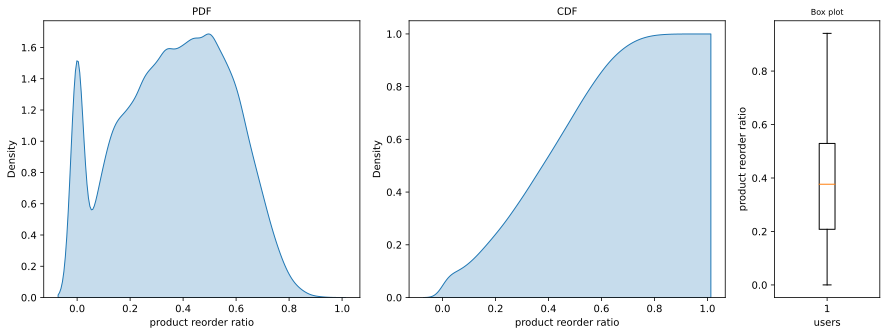

In [ ]:
univariate_analysis(product_features["p_reorder_ratio"], 'product reorder ratio')

**Which products have the lowest and  highest reorder ratio ?**

In [ ]:
maxx = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].max()]['product_id'].values[0]
minn = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].min()]['product_id'].values[0]

In [ ]:
print("Most reordered product with reorder_ratio = 0.94 , is: ")
merg_df_prior[merg_df_prior['product_id']==maxx].head(1)[['product_name','aisle','department']]

Most reordered product with reorder_ratio = 0.94 , is: 


,product_name,aisle,department
10099426,Raw Veggie Wrappers,prepared meals,deli


In [ ]:
print("Least reordered product with reorder_ratio = 0 , is: ")
merg_df_prior[merg_df_prior['product_id']==minn].head(1)[['product_name','aisle','department']]

Least reordered product with reorder_ratio = 0 , is: 


,product_name,aisle,department
18300348,Gluten Free Quinoa Three Cheese & Mushroom Blend,grains rice dried goods,dry goods pasta


**Observation/conclusion**

* There are many products that have a very low reorder_ratio, these are the rare and uncommon products, these products have a very low chance of being reordered.

* There are also many products that have a very high reorder_ratio, these frequently bought products, these products have a high chance of being reordered in general.

**f2) Product One time buy count and Product One time buy ratio**

Users that bought a particular product only once


formula: Product One time buy ratio = 
$$\frac{\text{Users that bought a product only once}}{\text{total unique users that bought the product}} $$

In [ ]:
times_users_bought_each_prod = merg_df_prior.groupby(by=['product_id','user_id']).agg({"reordered":"count"})['reordered'].reset_index()
times_users_bought_each_prod.head()

,product_id,user_id,reordered
0,1,138,2
1,1,709,1
2,1,764,2
3,1,777,1
4,1,825,1


In [ ]:
users_that_bought_a_prod_once = times_users_bought_each_prod[times_users_bought_each_prod['reordered'] == 1]
users_that_bought_a_prod_once.head()

,product_id,user_id,reordered
1,1,709,1
3,1,777,1
4,1,825,1
5,1,910,1
7,1,1379,1


In [ ]:
users_that_bought_a_prod_once = users_that_bought_a_prod_once.groupby(by=['product_id']).agg({"reordered":"sum"}).reset_index()
users_that_bought_a_prod_once = users_that_bought_a_prod_once.rename(columns = {"reordered":"p_one_time_buy_count"})
users_that_bought_a_prod_once.head()


,product_id,p_one_time_buy_count
0,1,440
1,2,70
2,3,38
3,4,118
4,5,2


In [ ]:
# Number of unique customers per product
unique_customers_per_prod = times_users_bought_each_prod.groupby(by=['product_id']).agg({"reordered":"count"}).reset_index()
unique_customers_per_prod.rename(columns = {"reordered":"unique_customers_per_prod"}, inplace=True)
unique_customers_per_prod.head()

,product_id,unique_customers_per_prod
0,1,716
1,2,78
2,3,74
3,4,182
4,5,6


In [ ]:
users_that_bought_a_prod_once = pd.merge(users_that_bought_a_prod_once, unique_customers_per_prod, on = 'product_id', how = 'left')
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod
0,1,440,716
1,2,70,78
2,3,38,74
3,4,118,182
4,5,2,6


In [ ]:
users_that_bought_a_prod_once['one_time_buy_ratio'] = users_that_bought_a_prod_once['p_one_time_buy_count'] / users_that_bought_a_prod_once['unique_customers_per_prod']
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,440,716,0.614525
1,2,70,78,0.897436
2,3,38,74,0.513514
3,4,118,182,0.648352
4,5,2,6,0.333333


products 3 has been bought only once 38 times.

In [ ]:
#Adding it to existing product features
product_features = pd.merge(product_features, users_that_bought_a_prod_once, on = 'product_id', how = 'left')
product_features = product_features.fillna(0) # Product that were never just ordered once have to have ratio = 0
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,0.613391,440.0,716.0,0.614525
1,2,0.133333,70.0,78.0,0.897436
2,3,0.732852,38.0,74.0,0.513514
3,4,0.446809,118.0,182.0,0.648352
4,5,0.600000,2.0,6.0,0.333333


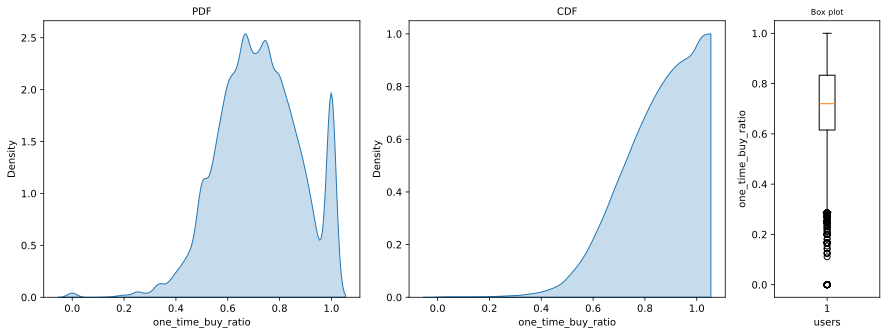

In [ ]:
univariate_analysis(product_features["one_time_buy_ratio"], 'one_time_buy_ratio')

In [ ]:
pd.merge(product_features[product_features['one_time_buy_ratio']==0].head(), products_df, on=['product_id'], how='left')

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,414,0.705882,0.0,0.0,0.0,Gluten Free Chicken Rustica Pizza,79,1
1,764,0.500000,0.0,0.0,0.0,Classic Butter Microwave Popcorn,23,19
2,802,0.851852,0.0,0.0,0.0,Organic Super Berry Juice,31,7
3,832,0.666667,0.0,0.0,0.0,High Protein Chocolate Light Milk Shake,65,11
4,2107,0.642857,0.0,0.0,0.0,Caramel Apple Filled Hard Candies,45,19


In [ ]:
print("Few products that were bought only once by many customers")
pd.merge(product_features[product_features['p_one_time_buy_count'] >15000].head(), products_df, on=['product_id'], how='left')

Few products that were bought only once by many customers


,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,13176,0.832555,18306.0,63537.0,0.288116,Bag of Organic Bananas,24,4
1,16797,0.698155,18700.0,43149.0,0.433382,Strawberries,24,4
2,21137,0.777704,20707.0,58838.0,0.351932,Organic Strawberries,24,4
3,21903,0.772500,18480.0,55037.0,0.335774,Organic Baby Spinach,123,4
4,24852,0.843501,18790.0,73956.0,0.254070,Banana,24,4


**Observations/Conclusions**

* Only a very few amont of products have been ordered only once, these products are most likely one time buys i.e people do not buy them more than once. Eg. 57 Steak Sauce. Either these products are normally bought only once or the product itself is very bad, so people once they buy it do not go for it again .

* There are few products that have one time ratio = 0. This means this product was always reordered by all users that bought it.

In [ ]:
product_features = product_features.merge(t)
product_features

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased
0,1,0.613391,440.0,716.0,0.614525,1852
1,2,0.133333,70.0,78.0,0.897436,90
2,3,0.732852,38.0,74.0,0.513514,277
3,4,0.446809,118.0,182.0,0.648352,329
4,5,0.600000,2.0,6.0,0.333333,15
...,...,...,...,...,...,...
49672,49684,0.111111,7.0,8.0,0.875000,9
49673,49685,0.122449,37.0,43.0,0.860465,49
49674,49686,0.700000,20.0,36.0,0.555556,120
49675,49687,0.461538,3.0,7.0,0.428571,13


**Filtering products by above features created**

In [ ]:
num_clusters = 10
sse=[]
sil_score = []
for i in range(1,num_clusters):
  kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0)
  kmeans.fit(product_features.set_index('product_id'))
  sse_iter = kmeans.inertia_
  sse.append(sse_iter)
  print(f"clsuter {i} Done")


clsuter 1 Done
clsuter 2 Done
clsuter 3 Done
clsuter 4 Done
clsuter 5 Done
clsuter 6 Done
clsuter 7 Done
clsuter 8 Done
clsuter 9 Done


Text(0, 0.5, 'SSE')

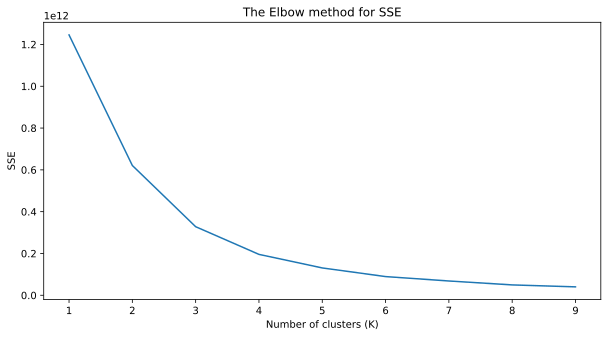

In [ ]:
plt.rcParams["figure.figsize"] = (10, 5)
plt.rcParams["xtick.labelsize"] = 10


number_clusters = range(1,num_clusters)
plt.plot(number_clusters,sse)
plt.title('The Elbow method for SSE')
plt.xlabel('Number of clusters (K)')
plt.xticks(number_clusters)
plt.ylabel('SSE')


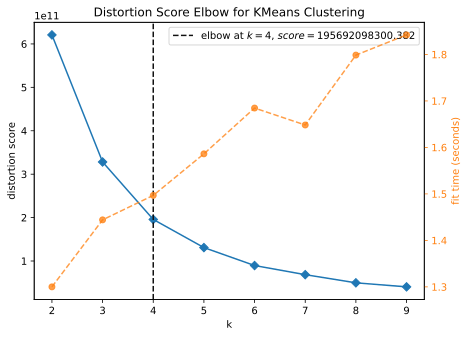

In [ ]:
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
plt.rcParams["figure.figsize"] = (7, 5)
plt.rcParams["xtick.labelsize"] = 10

kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0, random_state=4)
visualizer = KElbowVisualizer(kmeans, k=(2,10),locate_elbow= True, verbose = 1)

visualizer.fit(product_features.set_index('product_id'))        # Fit the data to the visualizer
visualizer.show()                                               # Finalize and render the figure

In [ ]:
chosen_k = [3,4,5,6,7]
for k in chosen_k:
  kmeans = KMeans(n_clusters = k, init='k-means++', verbose = 0, random_state = 0)
  kmeans.fit(product_features.set_index('product_id'))
  pred_cluster_labels = kmeans.labels_
  cluster = f'cluster_{k}'
  product_features[cluster] = pred_cluster_labels

# Extract cluster labels
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
0,1,0.613391,440.0,716.0,0.614525,1852,0,0,3,0,0
1,2,0.133333,70.0,78.0,0.897436,90,0,0,3,0,0
2,3,0.732852,38.0,74.0,0.513514,277,0,0,3,0,0
3,4,0.446809,118.0,182.0,0.648352,329,0,0,3,0,0
4,5,0.600000,2.0,6.0,0.333333,15,0,0,3,0,0


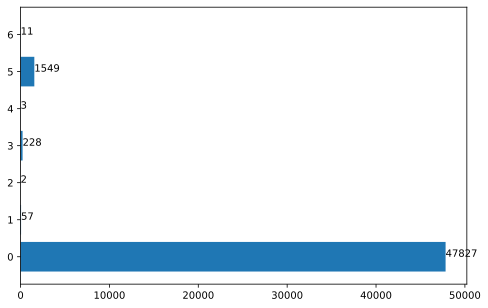

In [ ]:
cluster_counts = product_features.groupby(["cluster_7"]).agg({'cluster_7': ['count']})['cluster_7'].reset_index(drop=False)
cluster_counts

plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["xtick.labelsize"] = 10

import matplotlib.pyplot as plt
x = cluster_counts['cluster_7']
y = cluster_counts['count']
plt.barh(x, y)
 
for index, value in enumerate(y):
    plt.text(value, index,
             str(value))
plt.yticks(x)
plt.show()

In [ ]:
# source  https://medium.com/web-mining-is688-spring-2021/using-k-means-to-segment-customers-based-on-rfm-variables-9d4d683688c8

def snake_plot(X,y):

    #normalise df
    import pandas as pd
    from sklearn import preprocessing

    x = X.values
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    normalised_df = pd.DataFrame(x_scaled)
    normalised_df.columns = X.columns.values
    normalised_df['cluster_belonging_to'] = y.values


    # Melt data into long format
    df_melt = pd.melt(normalised_df, id_vars=['cluster_belonging_to'],
                            value_vars= X.columns.values, 
                            var_name='Metric', 
                            value_name='Value')
    
    plt.rcParams["figure.figsize"] = (18, 6)
    plt.rcParams["xtick.labelsize"] = 10


    plt.xlabel('Metric')
    plt.ylabel('Value')
    ax = sns.pointplot(data= df_melt, x='Metric', y='Value', hue='cluster_belonging_to')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, fontsize=10)
    ax.set_title("Snake plot of how all 3 clusters performed on the features")
    plt.show()
    return



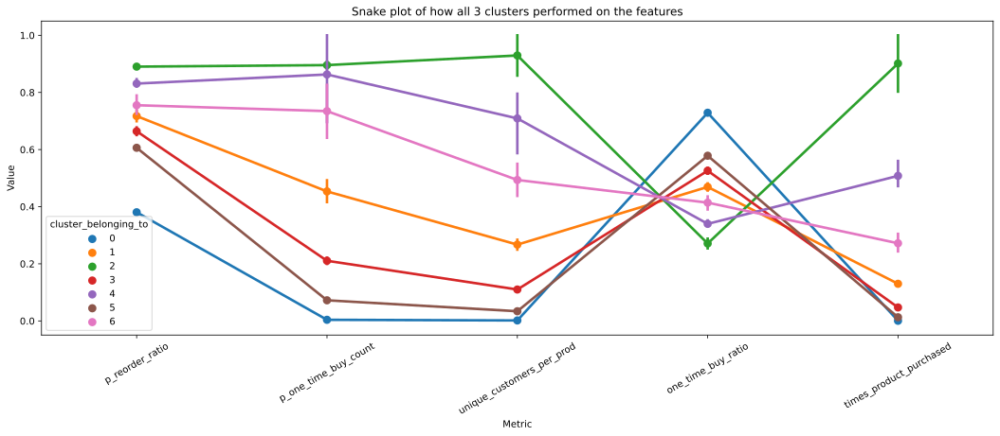

In [ ]:
snake_plot(product_features.iloc[:,1:-5], product_features.iloc[:,-1:])

**Cluster average, min and max stats**

In [ ]:
pd.set_option('display.max_columns', None)
product_features.iloc[:,1:].groupby(["cluster_7"]).agg(['median','min','max'])

p_reorder_ratio                     p_one_time_buy_count           \
                   median       min       max               median      min   
cluster_7                                                                     
0                0.367647  0.000000  0.941176                 23.0      0.0   
1                0.667283  0.476649  0.812274               9425.0   3572.0   
2                0.838028  0.832555  0.843501              18548.0  18306.0   
3                0.618178  0.275573  0.854342               4208.0    825.0   
4                0.777704  0.772500  0.796553              18480.0  14422.0   
5                0.585701  0.077194  0.860233               1260.0    168.0   
6                0.696038  0.628843  0.830354              14848.0   7798.0   

                   unique_customers_per_prod                    \
               max                    median      min      max   
cluster_7                                                        
0           1935.0                      32.0      0.0   2137.0   
1          16372.0                   19597.0   9295.0  29898.0   
2          18790.0                   68746.5  63537.0  73956.0   
3           8987.0                    7706.0   2942.0  15837.0   
4          20707.0                   55037.0  43453.0  58838.0   
5           6970.0                    2168.0    565.0   8433.0   
6          19838.0                   35115.0  23395.0  46402.0   

          one_time_buy_ratio                     times_product_purchased  \
                      median       min       max                  median   
cluster_7                                                                  
0                   0.727273  0.000000  1.000000                    54.0   
1                   0.467089  0.374201  0.622486                 58779.0   
2                   0.271093  0.254070  0.288116                426007.5   
3                   0.535393  0.280421  0.791090                 20015.5   
4                   0.335774  0.331899  0.351932                241921.0   
5                   0.573104  0.261087  0.934683                  5084.0   
6                   0.422839  0.333319  0.485944                137057.0   

                          cluster_3         cluster_4         cluster_5      \
              min     max    median min max    median min max    median min   
cluster_7                                                                     
0               1    3478       0.0   0   0       0.0   0   0       3.0   3   
1           42044   89632       1.0   1   1       1.0   1   3       2.0   2   
2          379450  472565       2.0   2   2       2.0   2   2       4.0   4   
3           13039   41473       0.0   0   1       3.0   3   3       0.0   0   
4          213584  264683       2.0   2   2       2.0   2   2       1.0   1   
5            2586   14869       0.0   0   0       0.0   0   3       3.0   0   
6           97315  176815       1.0   1   1       1.0   1   1       1.0   1   

              cluster_6          
          max    median min max  
cluster_7                        
0           3       0.0   0   0  
1           2       1.0   1   3  
2           4       5.0   5   5  
3           2       3.0   3   4  
4           1       2.0   2   2  
5           3       4.0   0   4  
6           2       2.0   1   2

**Discard all products from cluster 0, these are the products that hardly sell well**

In [ ]:
freq_products = product_features[product_features['cluster_7']!=0]
freq_products

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
33,34,0.600979,1470.0,2608.0,0.563650,6536,0,0,0,4,5
44,45,0.655461,3246.0,6344.0,0.511665,18413,0,3,0,3,3
78,79,0.534449,953.0,1669.0,0.571001,3585,0,0,3,4,5
94,95,0.147829,2098.0,2375.0,0.883368,2787,0,0,3,4,5
115,116,0.695802,630.0,1326.0,0.475113,4359,0,0,3,4,5
...,...,...,...,...,...,...,...,...,...,...,...
49593,49605,0.535501,1670.0,2728.0,0.612170,5873,0,0,3,4,5
49598,49610,0.752560,692.0,1788.0,0.387025,7226,0,0,0,4,5
49609,49621,0.643505,914.0,1652.0,0.553269,4634,0,0,3,4,5
49616,49628,0.661768,828.0,1657.0,0.499698,4899,0,0,3,4,5


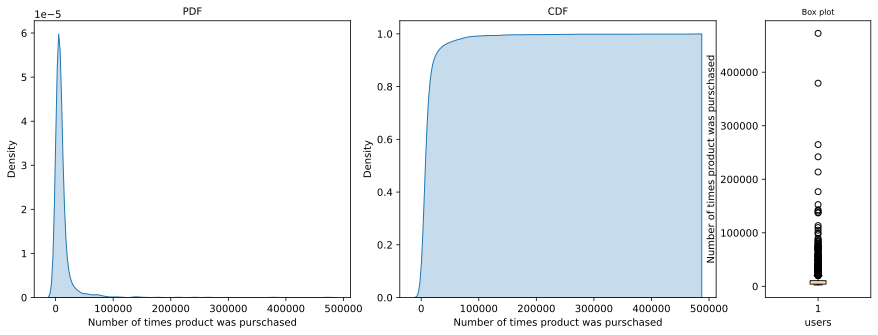

In [ ]:
univariate_analysis(freq_products['times_product_purchased'], "Number of times product was purschased")

In [ ]:
max_threshold = freq_products['times_product_purchased'].quantile(0.85)
print("Threshold", max_threshold)
v_freq_products = freq_products[freq_products['times_product_purchased'] > max_threshold]
v_freq_products.shape

Threshold 14844.849999999991


(278, 11)

In [ ]:
print("Which Departments the products we have filtered belong too and their count?")
merg_df_prior[merg_df_prior.product_id.isin(v_freq_products.product_id.unique())].groupby(['product_id']).first()['department'].value_counts()

Which Departments the products we have filtered belong too and their count?


produce            129
dairy eggs          67
beverages           24
frozen              10
deli                 9
canned goods         7
meat seafood         7
bakery               6
pantry               6
dry goods pasta      4
snacks               4
breakfast            3
household            2
Name: department, dtype: int64

In [ ]:
t= merg_df_prior[merg_df_prior.product_id.isin(v_freq_products.product_id.unique())].groupby(['product_id'], sort=False).first().reset_index()
t = t[['product_id', 'department','aisle','product_name' ]].groupby(['department'],  sort=False).head(3).reset_index(drop=True)
t.sort_values(['department'])[['department','aisle','product_name']].reset_index(drop=True)

,department,aisle,product_name
0,bakery,bread,Sourdough Bread
1,bakery,bread,100% Whole Wheat Bread
2,bakery,bread,Organic Bread with 21 Whole Grains
3,beverages,soft drinks,Soda
4,beverages,refrigerated,Original Orange Juice
5,beverages,water seltzer sparkling water,Sparkling Lemon Water
6,breakfast,cereal,Honey Nut Cheerios
7,breakfast,cereal,Raisin Bran Cereal
8,breakfast,hot cereal pancake mixes,Organic Old Fashioned Rolled Oats
9,canned goods,canned meals beans,Organic Black Beans


**Observation/conclusion**


* **Above are the top most popular products from each department**
* **This can be shown in trending section**
* **This recomendation will be same for all users**

## **Collaborative filtering (Products You may also be interested in)**

### Choosing only the most suitable users for matrix factorization.

In [ ]:
# Number of products bought by each user
t = merg_df_prior.groupby(by=['user_id','product_id']).agg({"reordered":"count"}).reset_index()
t = t.groupby(by = ['user_id']).agg({"product_id":"count"}).reset_index()
t = t.merge(user_loyalty_df[["user_id","cluster_4"]], on = ['user_id'])
# Using only loyal and regular customer data
t = t[ (t['cluster_4']==0) | (t['cluster_4']==2)]
t

,user_id,product_id,cluster_4
13,14,142,0
16,17,83,0
18,19,133,0
20,21,102,0
26,27,220,2
...,...,...,...
206199,206200,95,0
206200,206201,174,0
206205,206206,150,2
206206,206207,92,0


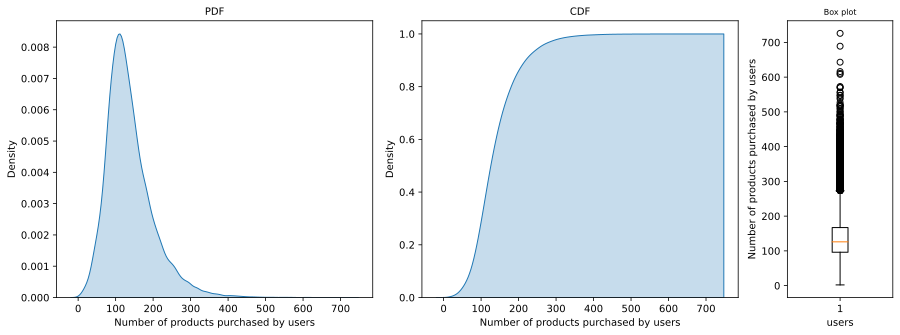

In [ ]:
univariate_analysis(t['product_id'], "Number of products purchased by users")

In [ ]:
# Getting only those users that bought more than 250 products, elbow method
freq_users = t[t['product_id'] > 300]
freq_users

,user_id,product_id,cluster_4
139,140,304,2
235,236,311,2
289,290,548,2
718,719,326,2
893,894,305,2
...,...,...,...
204314,204315,309,2
205212,205213,326,2
205236,205237,333,2
205279,205280,323,2


In [ ]:
freq_users['cluster_4'].value_counts()

2    846
0    221
Name: cluster_4, dtype: int64

**Observation and conclusions**

* We are going to choose only those regular and loyal customers that have purchased more than 250 products so far.

* These are the frequent and experienced buyers, thus using their data will be more valuable.

* After filtering nearly 2 lakh users we are left with 221 regular users and 846 loyal users. 


In [ ]:
freq_user_id = freq_users['user_id'].values
len(freq_user_id)

2833

### Choosing only the most suitable Products for matrix factorization.

In [ ]:
# Number of products bought by each user
t = merg_df_prior.groupby(by=['product_id']).agg({"reordered":"count"}).reset_index()
t.rename(columns = {"reordered":"times_product_purchased"},inplace = True)
t

,product_id,times_product_purchased
0,1,1852
1,2,90
2,3,277
3,4,329
4,5,15
...,...,...
49672,49684,9
49673,49685,49
49674,49686,120
49675,49687,13


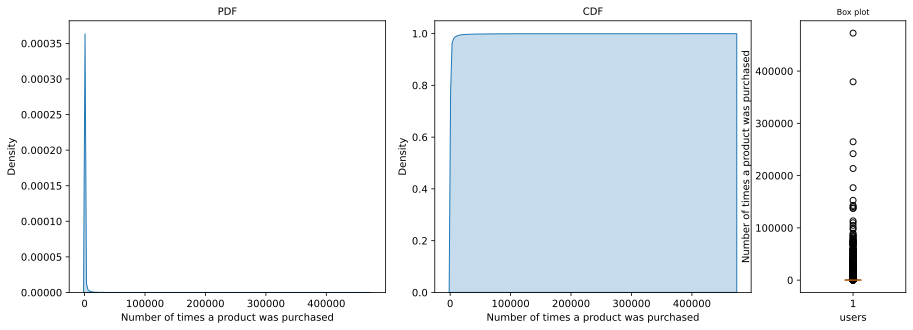

In [ ]:
univariate_analysis(t['times_product_purchased'], "Number of times a product was purchased")

**Product Features**

**f1) Average reorder ratio**



$$\frac{\text{total times the product was reordered}}{\text{total orders placed by all users}} $$

In [ ]:
p_reorder_ratio = merg_df_prior.groupby(by=['product_id']).agg({"reordered":"mean"})['reordered'].reset_index()
product_features = p_reorder_ratio.copy()
product_features.rename(columns = {"reordered":"p_reorder_ratio"}, inplace = True)
product_features.head()

,product_id,p_reorder_ratio
0,1,0.613391
1,2,0.133333
2,3,0.732852
3,4,0.446809
4,5,0.600000


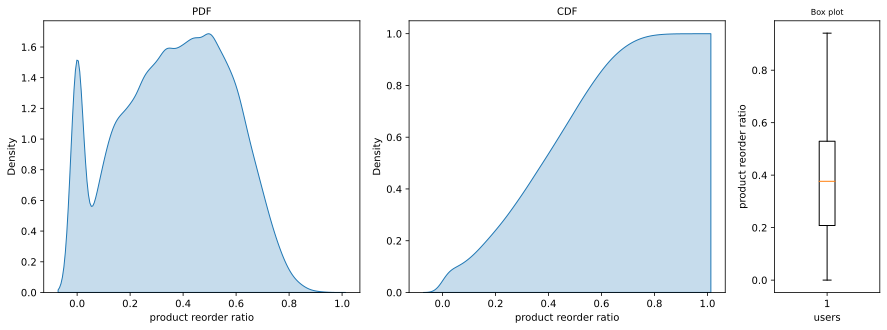

In [ ]:
univariate_analysis(product_features["p_reorder_ratio"], 'product reorder ratio')

**Which products have the lowest and  highest reorder ratio ?**

In [ ]:
maxx = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].max()]['product_id'].values[0]
minn = product_features[product_features["p_reorder_ratio"] == product_features["p_reorder_ratio"].min()]['product_id'].values[0]

In [ ]:
print("Most reordered product with reorder_ratio = 0.94 , is: ")
merg_df_prior[merg_df_prior['product_id']==maxx].head(1)[['product_name','aisle','department']]

Most reordered product with reorder_ratio = 0.94 , is: 


,product_name,aisle,department
10099426,Raw Veggie Wrappers,prepared meals,deli


In [ ]:
print("Least reordered product with reorder_ratio = 0 , is: ")
merg_df_prior[merg_df_prior['product_id']==minn].head(1)[['product_name','aisle','department']]

Least reordered product with reorder_ratio = 0 , is: 


,product_name,aisle,department
18300348,Gluten Free Quinoa Three Cheese & Mushroom Blend,grains rice dried goods,dry goods pasta


**Observation/conclusion**

* There are many products that have a very low reorder_ratio, these are the rare and uncommon products, these products have a very low chance of being reordered.

* There are also many products that have a very high reorder_ratio, these frequently bought products, these products have a high chance of being reordered in general.

**f2) Product One time buy count and Product One time buy ratio**

Users that bought a particular product only once


formula: Product One time buy ratio = 
$$\frac{\text{Users that bought a product only once}}{\text{total unique users that bought the product}} $$

In [ ]:
times_users_bought_each_prod = merg_df_prior.groupby(by=['product_id','user_id']).agg({"reordered":"count"})['reordered'].reset_index()
times_users_bought_each_prod.head()

,product_id,user_id,reordered
0,1,138,2
1,1,709,1
2,1,764,2
3,1,777,1
4,1,825,1


In [ ]:
users_that_bought_a_prod_once = times_users_bought_each_prod[times_users_bought_each_prod['reordered'] == 1]
users_that_bought_a_prod_once.head()

,product_id,user_id,reordered
1,1,709,1
3,1,777,1
4,1,825,1
5,1,910,1
7,1,1379,1


In [ ]:
users_that_bought_a_prod_once = users_that_bought_a_prod_once.groupby(by=['product_id']).agg({"reordered":"sum"}).reset_index()
users_that_bought_a_prod_once = users_that_bought_a_prod_once.rename(columns = {"reordered":"p_one_time_buy_count"})
users_that_bought_a_prod_once.head()


,product_id,p_one_time_buy_count
0,1,440
1,2,70
2,3,38
3,4,118
4,5,2


In [ ]:
# Number of unique customers per product
unique_customers_per_prod = times_users_bought_each_prod.groupby(by=['product_id']).agg({"reordered":"count"}).reset_index()
unique_customers_per_prod.rename(columns = {"reordered":"unique_customers_per_prod"}, inplace=True)
unique_customers_per_prod.head()

,product_id,unique_customers_per_prod
0,1,716
1,2,78
2,3,74
3,4,182
4,5,6


In [ ]:
users_that_bought_a_prod_once = pd.merge(users_that_bought_a_prod_once, unique_customers_per_prod, on = 'product_id', how = 'left')
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod
0,1,440,716
1,2,70,78
2,3,38,74
3,4,118,182
4,5,2,6


In [ ]:
users_that_bought_a_prod_once['one_time_buy_ratio'] = users_that_bought_a_prod_once['p_one_time_buy_count'] / users_that_bought_a_prod_once['unique_customers_per_prod']
users_that_bought_a_prod_once.head()

,product_id,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,440,716,0.614525
1,2,70,78,0.897436
2,3,38,74,0.513514
3,4,118,182,0.648352
4,5,2,6,0.333333


products 3 has been bought only once 38 times.

In [ ]:
#Adding it to existing product features
product_features = pd.merge(product_features, users_that_bought_a_prod_once, on = 'product_id', how = 'left')
product_features = product_features.fillna(0) # Product that were never just ordered once have to have ratio = 0
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio
0,1,0.613391,440.0,716.0,0.614525
1,2,0.133333,70.0,78.0,0.897436
2,3,0.732852,38.0,74.0,0.513514
3,4,0.446809,118.0,182.0,0.648352
4,5,0.600000,2.0,6.0,0.333333


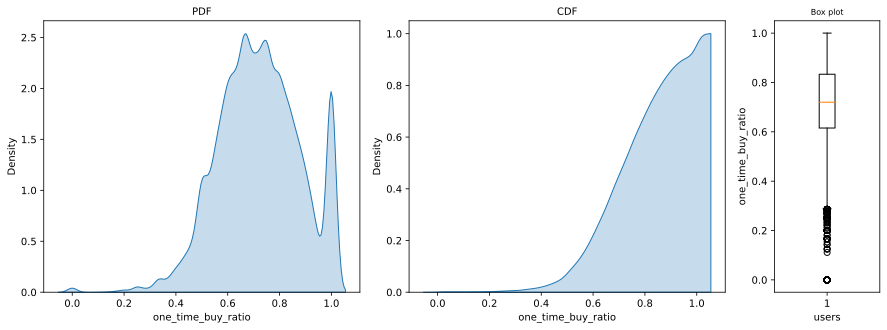

In [ ]:
univariate_analysis(product_features["one_time_buy_ratio"], 'one_time_buy_ratio')

In [ ]:
pd.merge(product_features[product_features['one_time_buy_ratio']==0].head(), products_df, on=['product_id'], how='left')

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,414,0.705882,0.0,0.0,0.0,Gluten Free Chicken Rustica Pizza,79,1
1,764,0.500000,0.0,0.0,0.0,Classic Butter Microwave Popcorn,23,19
2,802,0.851852,0.0,0.0,0.0,Organic Super Berry Juice,31,7
3,832,0.666667,0.0,0.0,0.0,High Protein Chocolate Light Milk Shake,65,11
4,2107,0.642857,0.0,0.0,0.0,Caramel Apple Filled Hard Candies,45,19


In [ ]:
print("Few products that were bought only once by many customers")
pd.merge(product_features[product_features['p_one_time_buy_count'] >15000].head(), products_df, on=['product_id'], how='left')

Few products that were bought only once by many customers


,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,product_name,aisle_id,department_id
0,13176,0.832555,18306.0,63537.0,0.288116,Bag of Organic Bananas,24,4
1,16797,0.698155,18700.0,43149.0,0.433382,Strawberries,24,4
2,21137,0.777704,20707.0,58838.0,0.351932,Organic Strawberries,24,4
3,21903,0.772500,18480.0,55037.0,0.335774,Organic Baby Spinach,123,4
4,24852,0.843501,18790.0,73956.0,0.254070,Banana,24,4


**Observations/Conclusions**

* Only a very few amont of products have been ordered only once, these products are most likely one time buys i.e people do not buy them more than once. Eg. 57 Steak Sauce. Either these products are normally bought only once or the product itself is very bad, so people once they buy it do not go for it again .

* There are few products that have one time ratio = 0. This means this product was always reordered by all users that bought it.

In [ ]:
product_features = product_features.merge(t)
product_features

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased
0,1,0.613391,440.0,716.0,0.614525,1852
1,2,0.133333,70.0,78.0,0.897436,90
2,3,0.732852,38.0,74.0,0.513514,277
3,4,0.446809,118.0,182.0,0.648352,329
4,5,0.600000,2.0,6.0,0.333333,15
...,...,...,...,...,...,...
49672,49684,0.111111,7.0,8.0,0.875000,9
49673,49685,0.122449,37.0,43.0,0.860465,49
49674,49686,0.700000,20.0,36.0,0.555556,120
49675,49687,0.461538,3.0,7.0,0.428571,13


**Filtering products by above features created**

In [ ]:
num_clusters = 10
sse=[]
sil_score = []
for i in range(1,num_clusters):
  kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0)
  kmeans.fit(product_features.set_index('product_id'))
  sse_iter = kmeans.inertia_
  sse.append(sse_iter)
  print(f"clsuter {i} Done")


clsuter 1 Done
clsuter 2 Done
clsuter 3 Done
clsuter 4 Done
clsuter 5 Done
clsuter 6 Done
clsuter 7 Done
clsuter 8 Done
clsuter 9 Done


Text(0, 0.5, 'SSE')

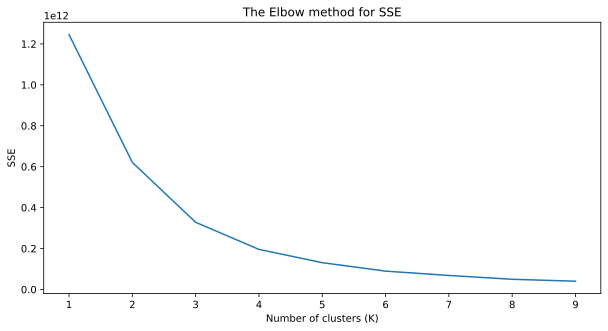

In [ ]:
plt.rcParams["figure.figsize"] = (10, 5)
plt.rcParams["xtick.labelsize"] = 10


number_clusters = range(1,num_clusters)
plt.plot(number_clusters,sse)
plt.title('The Elbow method for SSE')
plt.xlabel('Number of clusters (K)')
plt.xticks(number_clusters)
plt.ylabel('SSE')


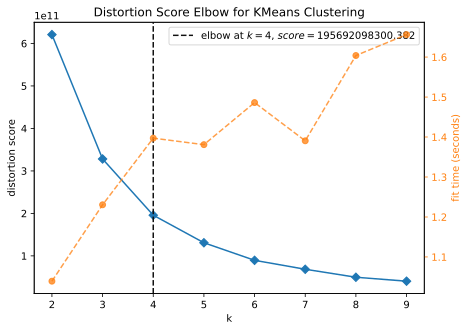

In [ ]:
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
plt.rcParams["figure.figsize"] = (7, 5)
plt.rcParams["xtick.labelsize"] = 10

kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0, random_state=4)
visualizer = KElbowVisualizer(kmeans, k=(2,10),locate_elbow= True, verbose = 1)

visualizer.fit(product_features.set_index('product_id'))        # Fit the data to the visualizer
visualizer.show()                                               # Finalize and render the figure

In [ ]:
chosen_k = [3,4,5,6,7]
for k in chosen_k:
  kmeans = KMeans(n_clusters = k, init='k-means++', verbose = 0, random_state = 0)
  kmeans.fit(product_features.set_index('product_id'))
  pred_cluster_labels = kmeans.labels_
  cluster = f'cluster_{k}'
  product_features[cluster] = pred_cluster_labels

# Extract cluster labels
product_features.head()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
0,1,0.613391,440.0,716.0,0.614525,1852,0,0,3,0,0
1,2,0.133333,70.0,78.0,0.897436,90,0,0,3,0,0
2,3,0.732852,38.0,74.0,0.513514,277,0,0,3,0,0
3,4,0.446809,118.0,182.0,0.648352,329,0,0,3,0,0
4,5,0.600000,2.0,6.0,0.333333,15,0,0,3,0,0


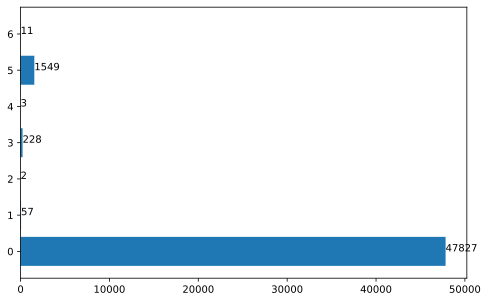

In [ ]:
cluster_counts = product_features.groupby(["cluster_7"]).agg({'cluster_7': ['count']})['cluster_7'].reset_index(drop=False)
cluster_counts

plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["xtick.labelsize"] = 10

import matplotlib.pyplot as plt
x = cluster_counts['cluster_7']
y = cluster_counts['count']
plt.barh(x, y)
 
for index, value in enumerate(y):
    plt.text(value, index,
             str(value))
plt.yticks(x)
plt.show()

In [ ]:
# source  https://medium.com/web-mining-is688-spring-2021/using-k-means-to-segment-customers-based-on-rfm-variables-9d4d683688c8

def snake_plot(X,y):

    #normalise df
    import pandas as pd
    from sklearn import preprocessing

    x = X.values
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    normalised_df = pd.DataFrame(x_scaled)
    normalised_df.columns = X.columns.values
    normalised_df['cluster_belonging_to'] = y.values


    # Melt data into long format
    df_melt = pd.melt(normalised_df, id_vars=['cluster_belonging_to'],
                            value_vars= X.columns.values, 
                            var_name='Metric', 
                            value_name='Value')
    
    plt.rcParams["figure.figsize"] = (18, 6)
    plt.rcParams["xtick.labelsize"] = 10


    plt.xlabel('Metric')
    plt.ylabel('Value')
    ax = sns.pointplot(data= df_melt, x='Metric', y='Value', hue='cluster_belonging_to')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, fontsize=10)
    ax.set_title("Snake plot of how all 3 clusters performed on the features")
    plt.show()
    return



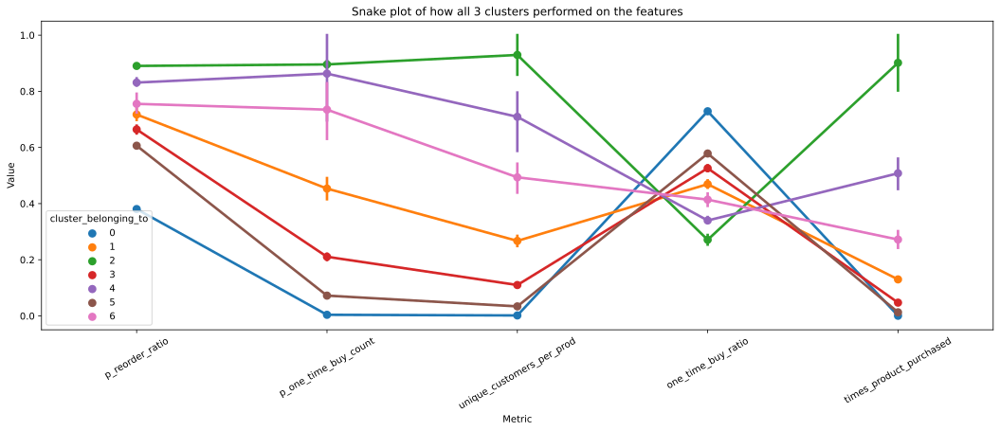

In [ ]:
snake_plot(product_features.iloc[:,1:-5], product_features.iloc[:,-1:])

**Cluster average, min and max stats**

In [ ]:
pd.set_option('display.max_columns', None)
product_features.iloc[:,1:].groupby(["cluster_7"]).agg(['median','min','max'])

p_reorder_ratio                     p_one_time_buy_count           \
                   median       min       max               median      min   
cluster_7                                                                     
0                0.367647  0.000000  0.941176                 23.0      0.0   
1                0.667283  0.476649  0.812274               9425.0   3572.0   
2                0.838028  0.832555  0.843501              18548.0  18306.0   
3                0.618178  0.275573  0.854342               4208.0    825.0   
4                0.777704  0.772500  0.796553              18480.0  14422.0   
5                0.585701  0.077194  0.860233               1260.0    168.0   
6                0.696038  0.628843  0.830354              14848.0   7798.0   

                   unique_customers_per_prod                    \
               max                    median      min      max   
cluster_7                                                        
0           1935.0                      32.0      0.0   2137.0   
1          16372.0                   19597.0   9295.0  29898.0   
2          18790.0                   68746.5  63537.0  73956.0   
3           8987.0                    7706.0   2942.0  15837.0   
4          20707.0                   55037.0  43453.0  58838.0   
5           6970.0                    2168.0    565.0   8433.0   
6          19838.0                   35115.0  23395.0  46402.0   

          one_time_buy_ratio                     times_product_purchased  \
                      median       min       max                  median   
cluster_7                                                                  
0                   0.727273  0.000000  1.000000                    54.0   
1                   0.467089  0.374201  0.622486                 58779.0   
2                   0.271093  0.254070  0.288116                426007.5   
3                   0.535393  0.280421  0.791090                 20015.5   
4                   0.335774  0.331899  0.351932                241921.0   
5                   0.573104  0.261087  0.934683                  5084.0   
6                   0.422839  0.333319  0.485944                137057.0   

                          cluster_3         cluster_4         cluster_5      \
              min     max    median min max    median min max    median min   
cluster_7                                                                     
0               1    3478       0.0   0   0       0.0   0   0       3.0   3   
1           42044   89632       1.0   1   1       1.0   1   3       2.0   2   
2          379450  472565       2.0   2   2       2.0   2   2       4.0   4   
3           13039   41473       0.0   0   1       3.0   3   3       0.0   0   
4          213584  264683       2.0   2   2       2.0   2   2       1.0   1   
5            2586   14869       0.0   0   0       0.0   0   3       3.0   0   
6           97315  176815       1.0   1   1       1.0   1   1       1.0   1   

              cluster_6          
          max    median min max  
cluster_7                        
0           3       0.0   0   0  
1           2       1.0   1   3  
2           4       5.0   5   5  
3           2       3.0   3   4  
4           1       2.0   2   2  
5           3       4.0   0   4  
6           2       2.0   1   2

**Discard all products from cluster 0, these are the products that hardly sell well**

In [ ]:
freq_products = product_features[product_features['cluster_7']!=0]
freq_products

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
33,34,0.600979,1470.0,2608.0,0.563650,6536,0,0,0,4,5
44,45,0.655461,3246.0,6344.0,0.511665,18413,0,3,0,3,3
78,79,0.534449,953.0,1669.0,0.571001,3585,0,0,3,4,5
94,95,0.147829,2098.0,2375.0,0.883368,2787,0,0,3,4,5
115,116,0.695802,630.0,1326.0,0.475113,4359,0,0,3,4,5
...,...,...,...,...,...,...,...,...,...,...,...
49593,49605,0.535501,1670.0,2728.0,0.612170,5873,0,0,3,4,5
49598,49610,0.752560,692.0,1788.0,0.387025,7226,0,0,0,4,5
49609,49621,0.643505,914.0,1652.0,0.553269,4634,0,0,3,4,5
49616,49628,0.661768,828.0,1657.0,0.499698,4899,0,0,3,4,5


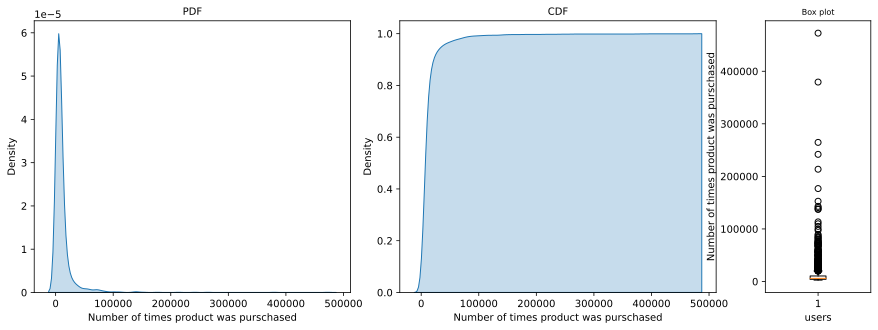

In [ ]:
univariate_analysis(freq_products['times_product_purchased'], "Number of times product was purschased")

In [ ]:
max_threshold = freq_products['times_product_purchased'].quantile(0.99)
print("Threshold", max_threshold)
v_freq_products = freq_products[freq_products['times_product_purchased'] > max_threshold]
v_freq_products.shape

Threshold 84645.15


(19, 11)

In [ ]:
v_freq_products.describe()

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
count,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000,19.000000
mean,28774.052632,0.735730,15300.263158,40623.842105,0.390012,170948.157895,1.263158,1.263158,1.736842,1.894737,4.473684
std,13695.191482,0.061101,3753.493763,14158.836221,0.060810,104665.668620,0.452414,0.452414,0.933459,1.196975,2.037657
min,5876.000000,0.628843,7798.000000,22510.000000,0.254070,85020.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,21520.000000,0.690801,12653.500000,30825.000000,0.343853,102441.500000,1.000000,1.000000,1.000000,1.000000,3.000000
50%,26209.000000,0.711922,14848.000000,37138.000000,0.413926,137905.000000,1.000000,1.000000,2.000000,2.000000,6.000000
75%,42141.000000,0.775102,18590.000000,45630.500000,0.433343,195199.500000,1.500000,1.500000,2.000000,2.000000,6.000000
max,49683.000000,0.843501,20707.000000,73956.000000,0.485944,472565.000000,2.000000,2.000000,4.000000,5.000000,6.000000


**Discard extremely frequently bought products, as they are bought by most users. THese can we shown as most Popular/trending products.**

In [ ]:
freq_products = freq_products[~freq_products.product_id.isin(v_freq_products.product_id.values)]
freq_products

,product_id,p_reorder_ratio,p_one_time_buy_count,unique_customers_per_prod,one_time_buy_ratio,times_product_purchased,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7
33,34,0.600979,1470.0,2608.0,0.563650,6536,0,0,0,4,5
44,45,0.655461,3246.0,6344.0,0.511665,18413,0,3,0,3,3
78,79,0.534449,953.0,1669.0,0.571001,3585,0,0,3,4,5
94,95,0.147829,2098.0,2375.0,0.883368,2787,0,0,3,4,5
115,116,0.695802,630.0,1326.0,0.475113,4359,0,0,3,4,5
...,...,...,...,...,...,...,...,...,...,...,...
49573,49585,0.314408,2046.0,2560.0,0.799219,3734,0,0,3,4,5
49593,49605,0.535501,1670.0,2728.0,0.612170,5873,0,0,3,4,5
49598,49610,0.752560,692.0,1788.0,0.387025,7226,0,0,0,4,5
49609,49621,0.643505,914.0,1652.0,0.553269,4634,0,0,3,4,5


In [ ]:
freq_products['times_product_purchased'].describe()

count     1831.000000
mean      9670.838340
std      11090.337879
min       2586.000000
25%       4072.500000
50%       5844.000000
75%      10353.500000
max      84255.000000
Name: times_product_purchased, dtype: float64

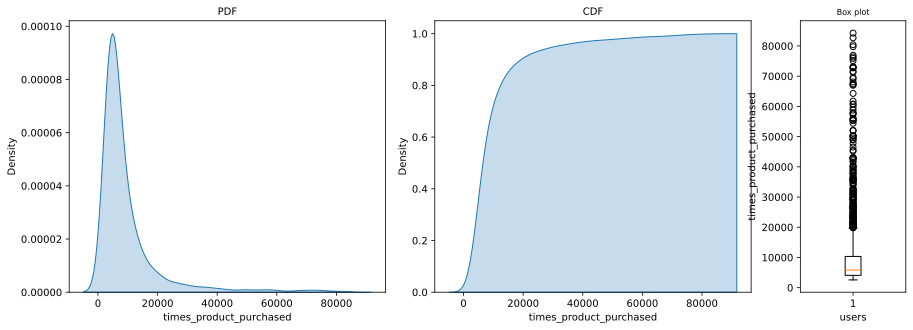

In [ ]:
univariate_analysis(freq_products['times_product_purchased'],"times_product_purchased")

**Conclusion**


**All the outliers were removed and termed as most popular products**

In [ ]:
freq_product_id = freq_products['product_id'].values
len(freq_product_id)

1831

In [ ]:
print("Which Departments the products we have filtered belong too and their count?")
merg_df_prior[merg_df_prior.product_id.isin(freq_product_id)].groupby(['product_id']).first()['department'].value_counts()

Which Departments the products we have filtered belong too and their count?


dairy eggs         378
produce            347
snacks             196
beverages          155
frozen             137
pantry             128
bakery              90
deli                70
canned goods        67
dry goods pasta     65
meat seafood        57
breakfast           51
household           37
babies              23
international       13
alcohol              7
personal care        6
bulk                 2
other                1
missing              1
Name: department, dtype: int64

### Building matrix

In [ ]:
filtered_purchases = merg_df_prior[ (merg_df_prior['user_id'].isin(freq_user_id)) & (merg_df_prior['product_id'].isin(freq_product_id))]
filtered_purchases

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
1016240,107326,49481,18,0,133,prior,2,6,18,2.0,Original Barbecue Sauce,5,13,marinades meat preparation,pantry
1016238,107326,41165,16,0,133,prior,2,6,18,2.0,Cheese Puffs,107,19,chips pretzels,snacks
1016228,107326,14992,6,0,133,prior,2,6,18,2.0,Green Beans,83,4,fresh vegetables,produce
2290259,241592,44570,4,1,133,prior,11,3,13,5.0,Kale Greens,83,4,fresh vegetables,produce
2290272,241592,41273,17,1,133,prior,11,3,13,5.0,Broccoli Florets,123,4,packaged vegetables fruits,produce
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31326379,3304125,18370,15,0,206174,prior,5,2,8,8.0,Organic Shredded Mozzarella,21,16,packaged cheese,dairy eggs
31326372,3304125,15649,8,1,206174,prior,5,2,8,8.0,Baby Seedless Cucumbers,83,4,fresh vegetables,produce
31326382,3304125,12576,18,0,206174,prior,5,2,8,8.0,Kiwi Sandia Sparkling Water,115,7,water seltzer sparkling water,beverages
31326371,3304125,5120,7,0,206174,prior,5,2,8,8.0,Organic Vanilla Soymilk,91,16,soy lactosefree,dairy eggs


In [ ]:
filtered_purchases = filtered_purchases.groupby(['product_id','user_id']).agg({"reordered":"count"})['reordered'].reset_index()
filtered_purchases.rename(columns = {"reordered":"times_user_purchased"}, inplace = True)
filtered_purchases

,product_id,user_id,times_user_purchased
0,34,236,3
1,34,894,8
2,34,1716,40
3,34,3593,1
4,34,3794,3
...,...,...,...
342186,49628,201976,2
342187,49628,202035,1
342188,49628,202849,5
342189,49628,202870,1


In [ ]:
univariate_analysis(filtered_purchases['times_user_purchased'].values, "times_user_purchased")

In [ ]:
thres = filtered_purchases['times_user_purchased'].quantile(0.99)
print("threshold",thres)
print(filtered_purchases[filtered_purchases['times_user_purchased']>thres]['times_user_purchased'].shape)

threshold 26.0
(3176,)


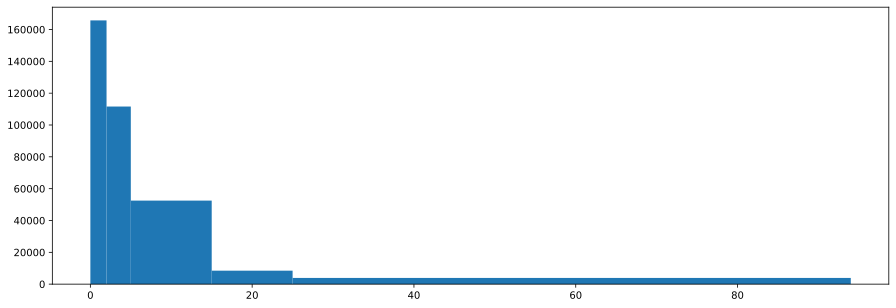

In [ ]:
import  matplotlib.pyplot as plt
mpgs = filtered_purchases['times_user_purchased'].values
a = plt.hist(mpgs, bins=[0, 2, 5, 15, 25, filtered_purchases['times_user_purchased'].max()])
plt.show()

In [ ]:
bin_boundaries = a[0]
print("bin_boundaries", bin_boundaries)
bin_density_counts = a[1]
print("bin_density_counts", bin_density_counts)

bin_boundaries [165734. 111613.  52477.   8449.   3918.]
bin_density_counts [ 0  2  5 15 25 94]


In [ ]:
#Binning

def binning(x):
  if x<=1:
    return 1
  elif x>=2 and x<=5:
    return 2
  elif x>=6 and x<=15:
    return 3
  elif x>=16 and x<=25:
    return 4
  else:
    return 5
  
filtered_purchases['times_user_purchased'] = filtered_purchases['times_user_purchased'].apply(binning)

In [ ]:
filtered_purchases['user_id'].unique().shape

(2833,)

In [ ]:
filtered_purchases['product_id'].unique().shape

(1750,)

In [ ]:
matrix = filtered_purchases.pivot_table(index= 'product_id', columns = 'user_id' , values = 'times_user_purchased')

In [ ]:
matrix.fillna(0, inplace = True)

In [ ]:
matrix

user_id     133     140     236     290     719     879     894     999     \
product_id                                                                   
34             0.0     0.0     2.0     0.0     0.0     0.0     3.0     0.0   
45             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
79             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
95             0.0     0.0     0.0     0.0     1.0     0.0     0.0     0.0   
116            0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
...            ...     ...     ...     ...     ...     ...     ...     ...   
49585          0.0     0.0     2.0     0.0     0.0     0.0     0.0     0.0   
49605          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49610          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49621          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49628          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   

user_id     1066    1139    1240    1242    1250    1264    1310    1424    \
product_id                                                                   
34             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
45             0.0     0.0     0.0     0.0     0.0     1.0     2.0     0.0   
79             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
95             0.0     0.0     0.0     0.0     0.0     1.0     0.0     1.0   
116            0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
...            ...     ...     ...     ...     ...     ...     ...     ...   
49585          0.0     0.0     0.0     0.0     2.0     0.0     0.0     0.0   
49605          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49610          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49621          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49628          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   

user_id     1519    1716    1793    1983    2100    2157    2258    2304    \
product_id                                                                   
34             0.0     5.0     0.0     0.0     0.0     0.0     0.0     0.0   
45             0.0     0.0     0.0     0.0     3.0     0.0     0.0     0.0   
79             0.0     0.0     0.0     0.0     0.0     0.0     2.0     0.0   
95             0.0     0.0     0.0     1.0     0.0     0.0     0.0     0.0   
116            0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
...            ...     ...     ...     ...     ...     ...     ...     ...   
49585          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49605          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49610          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49621          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49628          2.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   

user_id     2335    2409    2535    2561    2663    2688    2799    2951    \
product_id                                                                   
34             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
45             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
79             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
95             0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
116            0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
...            ...     ...     ...     ...     ...     ...     ...     ...   
49585          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49605          0.0     0.0     0.0     0.0     0.0     0.0     0.0     0.0   
49610          0.0     0.0     5.0     0.0     0.0     0.0     0.0     0.0   
49621          0.0     0.0     0.0     0.0     0.0     0.0     1.0     0.0   
49628          0.0 

In [ ]:
print(f"This matrix is { round((1.0 - (np.count_nonzero(matrix) / matrix.size)),2)* 100}% sparse")

This matrix is 93.0% sparse


### **Products You may also like** using product similarity

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
prod_sim_scores = cosine_similarity(matrix)
prod_sim_scores.shape

(1750, 1750)

In [ ]:
def you_may_also_like(prod_id):
  prod_idx = np.where(matrix.index==prod_id)[0][0]
  sim_products = sorted(list(enumerate(prod_sim_scores[prod_idx])), key = lambda score:score[1], reverse = True)[1:4]

  print("Products similar to ", products_df[products_df.product_id == prod_id]['product_name'].values[0],"are:\n\n")
  for sim_prod_idx in sim_products:
    sim_product_id = matrix.index[sim_prod_idx[0]]
    print(products_df[products_df.product_id == sim_product_id]['product_name'].values[0] ,"  similarity score:" ,sim_prod_idx[1])


In [ ]:
prod_id=49628

you_may_also_like(prod_id)

Products similar to  Yoghurt Blueberry are:


Tart Cherry Yoghurt   similarity score: 0.4482377995709831
Raspberry Yoghurt   similarity score: 0.33156928917276224
Blueberry Yoghurt   similarity score: 0.2991976429266435


In [ ]:
prod_id=25466

you_may_also_like(prod_id)

Products similar to  Water are:


1 Liter   similarity score: 0.2563413196550354
Natural Artesian Water   similarity score: 0.1911928062689101
Natural Spring Water   similarity score: 0.1526844272935654


In [ ]:
prod_id=781

you_may_also_like(prod_id)

Products similar to  Organic Shredded Mild Cheddar are:


Organic Shredded Mozzarella   similarity score: 0.3383787778895413
Organic Sour Cream   similarity score: 0.2703573470476888
Organic Russet Potato   similarity score: 0.25017976722470336


In [ ]:
prod_id=3098

you_may_also_like(prod_id)

Products similar to  Lavender Dish Soap are:


Lavender Hand Soap   similarity score: 0.2336361661554236
Lemon Verbena Dish Soap   similarity score: 0.20052445571436361
100% Recycled Paper Towels   similarity score: 0.17549312687664495


In [ ]:
prod_id=311

you_may_also_like(prod_id)

Products similar to  Naturals Savory Turkey Breakfast Sausage are:


Natural Chicken & Sage Breakfast Sausage   similarity score: 0.33952097381824276
Chicken & Maple Breakfast Sausage   similarity score: 0.269621927811937
Natural Classic Pork Breakfast Sausage   similarity score: 0.2547087637560087


In [ ]:
# filtered_purchases['product_id'].unique()[888:1000]

### Matrix Factorization (TODO)

* To recommend products to frequent users.
* To check product similarity once again

## **Creating Bundles using market basket analysis (Products often bought together)**

Since using all orders is not feasible, we filter only those orders have minimum x products in it.

In [ ]:
t = merg_df_prior.groupby(['department','product_id'], ).agg({"reordered":"count",'department': 'first', 'product_name': 'first', 'product_id': 'first'}).reset_index(drop=True)
t = t.sort_values(['department','reordered'], ascending = [True, False]).reset_index(drop=True)
t

,reordered,department,product_name,product_id
0,8246,alcohol,Sauvignon Blanc,2120
1,6153,alcohol,Chardonnay,38444
2,6115,alcohol,Cabernet Sauvignon,33065
3,5844,alcohol,Beer,46088
4,5475,alcohol,Vodka,45190
...,...,...,...,...
49672,1,snacks,Lindor Peppermint White Chocolate Truffles,35542
49673,1,snacks,Strawberry Energy Gel,43778
49674,1,snacks,Mustard & Onion,44986
49675,1,snacks,Original Salted Caramel Protein Energy Bar,45380


In [ ]:
top_bought_prods_per_dept = t.groupby('department').head(1000).drop_duplicates(keep='first')
top_bought_prods_per_dept

,reordered,department,product_name,product_id
0,8246,alcohol,Sauvignon Blanc,2120
1,6153,alcohol,Chardonnay,38444
2,6115,alcohol,Cabernet Sauvignon,33065
3,5844,alcohol,Beer,46088
4,5475,alcohol,Vodka,45190
...,...,...,...,...
44409,592,snacks,"Cherry, Dark Chocolate & Almond Granola bar",10210
44410,591,snacks,Double Stuf Golden Sandwich Cookies,30910
44411,590,snacks,Beef Jerky Original,8049
44412,589,snacks,Craisins Dried Cranberries,39157


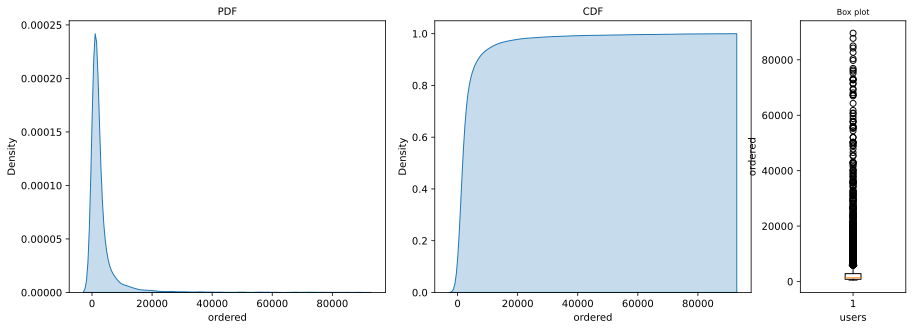

In [ ]:
univariate_analysis(top_bought_prods_per_dept[(top_bought_prods_per_dept['reordered']>500) & (top_bought_prods_per_dept['reordered']<90000)]['reordered'], "ordered")

In [ ]:
top_bought_prods_per_dept[ (top_bought_prods_per_dept['reordered'] < 300)]

,reordered,department,product_name,product_id
99,295,alcohol,Marlborough Sauvignon Blanc Wine,18404
100,295,alcohol,Draught,40364
101,285,alcohol,Summer Pack Variety Bottles,28573
102,280,alcohol,Petite Sirah,21715
103,275,alcohol,Champagne,1808
...,...,...,...,...
42725,167,produce,White Mushrooms,20547
42726,166,produce,Cilantro Paste,16144
42727,165,produce,Sliced Crimini Mushrooms,2965
42728,165,produce,Bag Carrots,47959


In [ ]:
top_bought_prods_per_dept = top_bought_prods_per_dept[ (top_bought_prods_per_dept['reordered']>300)]
top_bought_prods_id_per_dept = top_bought_prods_per_dept.product_id.values
top_bought_prods_per_dept

,reordered,department,product_name,product_id
0,8246,alcohol,Sauvignon Blanc,2120
1,6153,alcohol,Chardonnay,38444
2,6115,alcohol,Cabernet Sauvignon,33065
3,5844,alcohol,Beer,46088
4,5475,alcohol,Vodka,45190
...,...,...,...,...
44409,592,snacks,"Cherry, Dark Chocolate & Almond Granola bar",10210
44410,591,snacks,Double Stuf Golden Sandwich Cookies,30910
44411,590,snacks,Beef Jerky Original,8049
44412,589,snacks,Craisins Dried Cranberries,39157


In [ ]:
t= (merg_df_prior[["order_id","add_to_cart_order","product_name","product_id","reordered"]]
.groupby(["order_id"])
.agg({"reordered":"count"})).reset_index()
t

,order_id,reordered
0,2,9
1,3,8
2,4,13
3,5,26
4,6,3
...,...,...
3214869,3421079,1
3214870,3421080,9
3214871,3421081,7
3214872,3421082,7


In [ ]:
univariate_analysis(t['reordered'],"order size")

In [ ]:
largest_order_df = t[t.reordered>35]
largest_order_id = largest_order_df.order_id.values
largest_order_df

,order_id,reordered
250,265,36
299,315,38
409,431,36
430,454,44
518,549,36
...,...,...
3214295,3420466,39
3214491,3420671,37
3214631,3420822,45
3214748,3420947,39


In [ ]:
filtered_purchases = merg_df_prior[ (merg_df_prior['order_id'].isin(largest_order_id)) & (merg_df_prior['product_id'].isin(top_bought_prods_id_per_dept))]
filtered_purchases['ordered'] = 1
filtered_purchases

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department,ordered
645792,68288,48204,35,0,10,prior,2,5,15,30.0,Tamari Gluten Free Soy Sauce,66,6,asian foods,international,1
645803,68288,47526,46,0,10,prior,2,5,15,30.0,Goat Cheese Log,21,16,packaged cheese,dairy eggs,1
645759,68288,47380,2,0,10,prior,2,5,15,30.0,New York Style Nova Lox,15,12,packaged seafood,meat seafood,1
645778,68288,47042,21,0,10,prior,2,5,15,30.0,Organic Red On the Vine Tomato,83,4,fresh vegetables,produce,1
645758,68288,46979,1,1,10,prior,2,5,15,30.0,Asparagus,83,4,fresh vegetables,produce,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32432063,3420822,7175,25,0,206165,prior,27,4,21,9.0,Organic Whipped Naturally Buttery Spread,91,16,soy lactosefree,dairy eggs,1
32432048,3420822,6999,10,0,206165,prior,27,4,21,9.0,Organic Fresh Pressed Pure Lemon Juice,98,7,juice nectars,beverages,1
32432068,3420822,1529,30,0,206165,prior,27,4,21,9.0,"Parsley, Italian (Flat), New England Grown",16,4,fresh herbs,produce,1
32432057,3420822,261,19,0,206165,prior,27,4,21,9.0,Organic Southwestern Burrito,38,1,frozen meals,frozen,1


In [ ]:
order_baskets = filtered_purchases.pivot_table(index= 'order_id', columns = 'product_name' , values = 'ordered')

In [ ]:
order_baskets.fillna(0, inplace = True)
order_baskets

product_name,#2 Coffee Filters,0% Fat Free Organic Milk,0% Fat Organic Greek Vanilla Yogurt,0% Fat Superfruits Greek Yogurt,0% Greek Strained Yogurt,0% Greek Yogurt Black Cherry on the Bottom,"0% Greek, Blueberry on the Bottom Yogurt",1 % Lowfat Milk,1 Apple + 1 Mango Fruit Bar,1 Apple + 1 Pear Fruit Bar,...,Zucchini Noodles,Zucchini Soufflé,Zucchini Squash,for Tots Apple Juice,gel hand wash sea minerals,of Hanover 100 Calorie Pretzels Mini,smartwater® Electrolyte Enhanced Water,vitaminwater® XXX Acai Blueberry Pomegranate,with Crispy Almonds Cereal,with Olive Oil Mayonnaise
order_id,,,,,,,,,,,,,,,,,,,,,
265,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
315,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
431,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
454,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
549,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3420466,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420671,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3420822,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
print(f"This matrix is { round((1.0 - (np.count_nonzero(order_baskets) / order_baskets.size)),4)* 100}% sparse")

This matrix is 99.62% sparse


In [ ]:
import mlxtend
from mlxtend.frequent_patterns import apriori, fpgrowth
from mlxtend.frequent_patterns import association_rules

freq_items = fpgrowth(order_baskets,min_support = 0.01, use_colnames = True)
rules = association_rules(freq_items, metric =  'lift', min_threshold = 1)

/usr/local/lib/python3.7/dist-packages/mlxtend/frequent_patterns/fpcommon.py:115: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  DeprecationWarning,


In [ ]:
rules.sort_values(by=['confidence','support'], ascending=[False, False], inplace = True)
#Filter records that have confidence less than 60
bundles = rules[['antecedents','consequents','confidence']][rules['confidence']>=0.25]
bundles

,antecedents,consequents,confidence
2497,"(Organic Raspberries, Organic Lemon, Organic H...",(Bag of Organic Bananas),0.658696
3927,"(Organic Raspberries, Organic Navel Orange)",(Bag of Organic Bananas),0.641237
3921,"(Organic Navel Orange, Organic Hass Avocado)",(Bag of Organic Bananas),0.630332
1458,"(Organic Large Extra Fancy Fuji Apple, Organic...",(Bag of Organic Bananas),0.617769
2496,"(Organic Raspberries, Organic Lemon, Bag of Or...",(Organic Hass Avocado),0.615854
...,...,...,...
3522,(Extra Virgin Olive Oil),(Organic Baby Spinach),0.250000
4184,(Organic Lacinato (Dinosaur) Kale),(Organic Yellow Onion),0.250000
1772,"(Organic Yellow Onion, Organic Baby Spinach)",(Organic Zucchini),0.250000
2832,(Organic Carrot Bunch),(Organic Garlic),0.250000


In [ ]:
bundles.iloc[500:550,:]

,antecedents,consequents,confidence
258,"(Organic Whole Milk, Bag of Organic Bananas)",(Organic Hass Avocado),0.398551
4310,(Non Fat Raspberry Yogurt),(Vanilla Skyr Nonfat Yogurt),0.398263
4718,(Organic Baby Rainbow Carrots),(Bag of Organic Bananas),0.397887
2167,"(Organic Garnet Sweet Potato (Yam), Bag of Org...",(Organic Baby Spinach),0.397814
2999,"(Organic Baby Arugula, Bag of Organic Bananas)",(Organic Strawberries),0.397783
2498,"(Organic Lemon, Bag of Organic Bananas, Organi...",(Organic Raspberries),0.397638
3542,"(Organic Garlic, Organic Baby Spinach)",(Bag of Organic Bananas),0.397582
3377,"(Organic Grape Tomatoes, Organic Hass Avocado)",(Organic Baby Spinach),0.397289
56,"(Organic Yellow Onion, Organic Baby Spinach)",(Organic Hass Avocado),0.397230
1669,"(Organic Zucchini, Organic Hass Avocado)",(Organic Baby Spinach),0.397096
